# Used Cars Price Prediction

### import libraries

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

from dataprep.eda import create_report


from sklearn import metrics
from sklearn.ensemble import ExtraTreesRegressor
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import RandomizedSearchCV

import xgboost as xgb
from scipy.stats import uniform, randint


from lightgbm import LGBMRegressor
from catboost import CatBoostRegressor

import warnings
warnings.filterwarnings('ignore')

In [2]:
df=pd.read_csv('car_prediction_data.csv')
df.head()

,Car_Name,Year,Selling_Price,Present_Price,Kms_Driven,Fuel_Type,Seller_Type,Transmission,Owner
0,ritz,2014,3.35,5.59,27000,Petrol,Dealer,Manual,0
1,sx4,2013,4.75,9.54,43000,Diesel,Dealer,Manual,0
2,ciaz,2017,7.25,9.85,6900,Petrol,Dealer,Manual,0
3,wagon r,2011,2.85,4.15,5200,Petrol,Dealer,Manual,0
4,swift,2014,4.60,6.87,42450,Diesel,Dealer,Manual,0


In [3]:
df.shape

(301, 9)

In [4]:
df=df[['Year','Selling_Price','Present_Price','Kms_Driven','Fuel_Type','Seller_Type','Transmission','Owner']]
df['Current_Year']=2022
df['no_of_years']=df['Current_Year']- df['Year']
df.drop(['Year'],axis=1,inplace=True)
df.head()

,Selling_Price,Present_Price,Kms_Driven,Fuel_Type,Seller_Type,Transmission,Owner,Current_Year,no_of_years
0,3.35,5.59,27000,Petrol,Dealer,Manual,0,2022,8
1,4.75,9.54,43000,Diesel,Dealer,Manual,0,2022,9
2,7.25,9.85,6900,Petrol,Dealer,Manual,0,2022,5
3,2.85,4.15,5200,Petrol,Dealer,Manual,0,2022,11
4,4.60,6.87,42450,Diesel,Dealer,Manual,0,2022,8


  0%|                                                                                         | 0/1247 [00:00<…

Car parice prediction
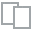
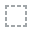
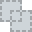
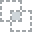
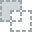
...
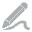
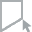
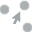
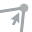
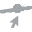

In [5]:
create_report(df, title='Car parice prediction')

In [6]:
df=pd.get_dummies(df,drop_first=True)
df=df.drop(['Current_Year'],axis=1)
df.head()

,Selling_Price,Present_Price,Kms_Driven,Owner,no_of_years,Fuel_Type_Diesel,Fuel_Type_Petrol,Seller_Type_Individual,Transmission_Manual
0,3.35,5.59,27000,0,8,0,1,0,1
1,4.75,9.54,43000,0,9,1,0,0,1
2,7.25,9.85,6900,0,5,0,1,0,1
3,2.85,4.15,5200,0,11,0,1,0,1
4,4.60,6.87,42450,0,8,1,0,0,1


In [7]:
X = df.iloc[:,1:]
y = df.iloc[:,0]

In [8]:
model = ExtraTreesRegressor()
model.fit(X,y)
print(model.feature_importances_)

[0.37144995 0.04027322 0.00135485 0.07936016 0.22664909 0.00867639
 0.1288999  0.14333644]


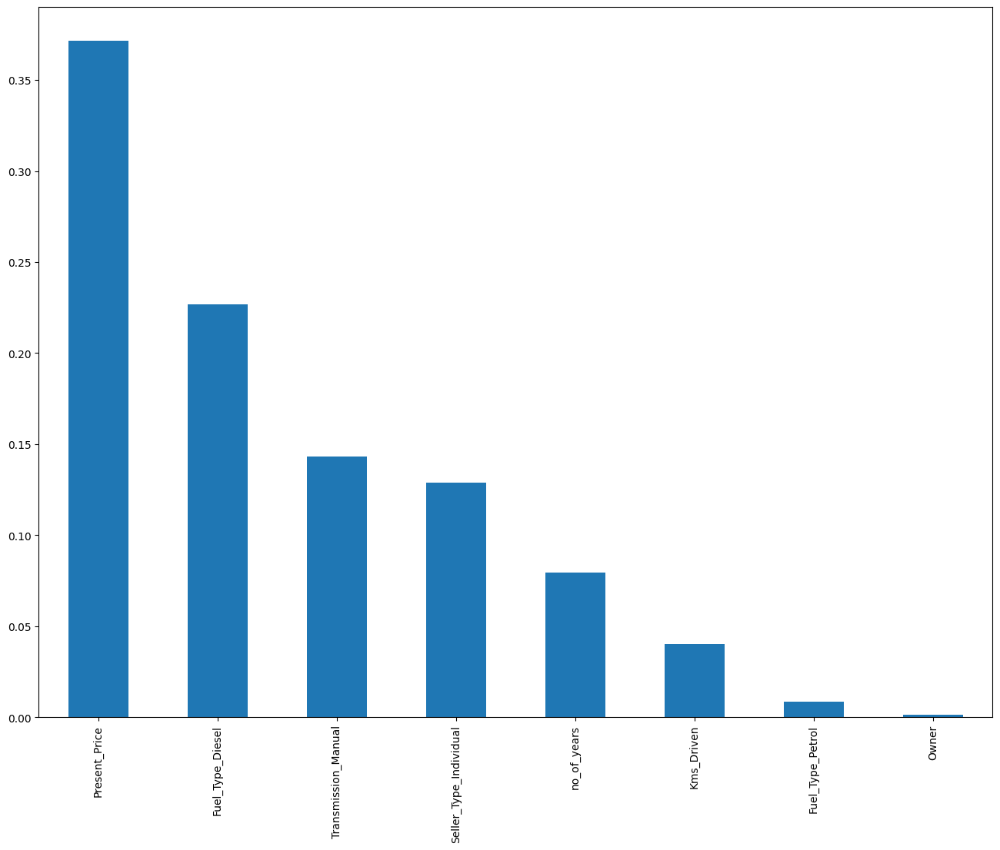

In [9]:
plt.figure(figsize=(16, 12))
feat_importances = pd.Series(model.feature_importances_, index=X.columns)
feat_importances.nlargest(len(df.columns)).plot(kind='bar')
plt.show()

In [10]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=0)

# Random Forest Regressor

In [11]:
regressor=RandomForestRegressor()

n_estimators = [int(x) for x in np.linspace(start = 100, stop = 1200, num = 12)]
max_features = ['auto', 'sqrt']
max_depth = [int(x) for x in np.linspace(5, 30, num = 6)]
min_samples_split = [2, 5, 10, 15, 100]
min_samples_leaf = [1, 2, 5, 10]

In [12]:
random_grid = {'n_estimators': n_estimators,
               'max_features': max_features,
               'max_depth': max_depth,
               'min_samples_split': min_samples_split,
               'min_samples_leaf': min_samples_leaf}

print(random_grid)

{'n_estimators': [100, 200, 300, 400, 500, 600, 700, 800, 900, 1000, 1100, 1200], 'max_features': ['auto', 'sqrt'], 'max_depth': [5, 10, 15, 20, 25, 30], 'min_samples_split': [2, 5, 10, 15, 100], 'min_samples_leaf': [1, 2, 5, 10]}


In [13]:
rf = RandomForestRegressor()
# Use the random grid to search for best hyperparameters
rf=RandomizedSearchCV(estimator = rf, param_distributions = random_grid,scoring='neg_mean_squared_error', n_iter = 10, random_state=42, n_jobs = -1)

In [14]:
rf.fit(X_train,y_train)

RandomizedSearchCV(estimator=RandomForestRegressor(), n_jobs=-1,
                   param_distributions={'max_depth': [5, 10, 15, 20, 25, 30],
                                        'max_features': ['auto', 'sqrt'],
                                        'min_samples_leaf': [1, 2, 5, 10],
                                        'min_samples_split': [2, 5, 10, 15,
                                                              100],
                                        'n_estimators': [100, 200, 300, 400,
                                                         500, 600, 700, 800,
                                                         900, 1000, 1100,
                                                         1200]},
                   random_state=42, scoring='neg_mean_squared_error')

In [15]:
rf_best_param = rf.best_params_
rf_best_score = rf.best_score_

print('Random Forest Best Params: ', rf_best_param)
print('Random Forest Best Score: ', rf_best_score)

Random Forest Best Params:  {'n_estimators': 1000, 'min_samples_split': 2, 'min_samples_leaf': 1, 'max_features': 'sqrt', 'max_depth': 25}
Random Forest Best Score:  -4.031466653729001


In [16]:
rf_pred=rf.predict(X_test)

<AxesSubplot: xlabel='Selling_Price', ylabel='Density'>

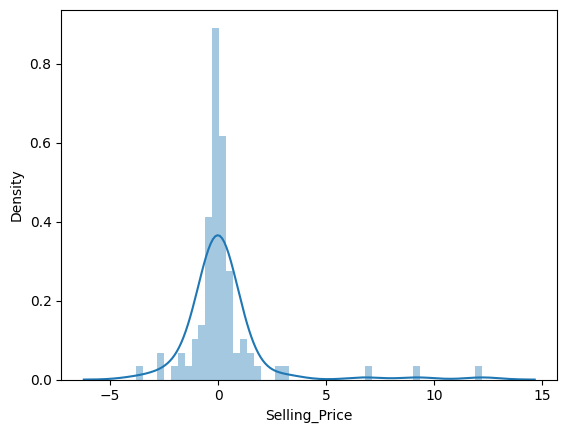

In [17]:
sns.distplot(y_test-rf_pred)

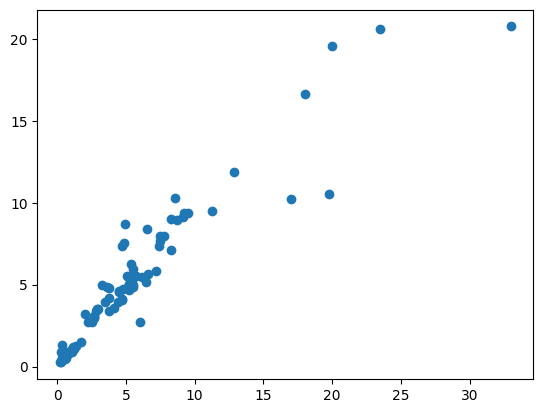

In [18]:
plt.scatter(y_test,rf_pred)
plt.show()

In [19]:
rf_MAE = metrics.mean_absolute_error(y_test, rf_pred)
rf_MSE = metrics.mean_squared_error(y_test, rf_pred)
rf_RMSE = np.sqrt(metrics.mean_squared_error(y_test, rf_pred))
rf_R2 = metrics.r2_score(y_test, rf_pred)


print('MAE: ', rf_MAE)
print('MSE:',  rf_MSE)
print('RMSE:', rf_RMSE)
print('R2:',   rf_R2)

MAE:  0.885415164835163
MSE: 3.9865880775494507
RMSE: 1.996644204045741
R2: 0.8666962977948849


# XGBoost Regressor

In [20]:
xgb_model = xgb.XGBRegressor(objective="reg:linear", random_state=42)

params = {
    "gamma": uniform(0, 0.5),
    "learning_rate": uniform(0.03, 0.3), # default 0.1 
    "max_depth": randint(2, 6), # default 3
    "n_estimators": randint(100, 150), # default 100
    "subsample": uniform(0.6, 0.4)
}

xgb = RandomizedSearchCV(estimator = xgb_model, param_distributions = params,scoring='neg_mean_squared_error', n_iter = 10, random_state=42, n_jobs = -1)

In [21]:
xgb.fit(X_train,y_train)

[10:23:21] WARNING: C:/Users/administrator/workspace/xgboost-win64_release_1.6.0/src/objective/regression_obj.cu:203: reg:linear is now deprecated in favor of reg:squarederror.


RandomizedSearchCV(estimator=XGBRegressor(base_score=None, booster=None,
                                          callbacks=None,
                                          colsample_bylevel=None,
                                          colsample_bynode=None,
                                          colsample_bytree=None,
                                          early_stopping_rounds=None,
                                          enable_categorical=False,
                                          eval_metric=None, gamma=None,
                                          gpu_id=None, grow_policy=None,
                                          importance_type=None,
                                          interaction_constraints=None,
                                          learning_rate=None, max_bin=None,
                                          max_ca...
                                        'learning_rate': <scipy.stats._distn_infrastructure.rv_continuous_frozen object at 0x00000295FBE8D600>,
                                        'max_depth': <scipy.stats._distn_infrastructure.rv_discrete_frozen object at 0x00000295FBE8EE90>,
                                        'n_estimators': <scipy.stats._distn_infrastructure.rv_discrete_frozen object at 0x00000295FBE8EA10>,
                                        'subsample': <scipy.stats._distn_infrastructure.rv_continuous_frozen object at 0x00000295FBE8C0D0>},
                   random_state=42, scoring='neg_mean_squared_error')

In [22]:
xgb_best_param = xgb.best_params_
xgb_best_score = xgb.best_score_

print('XGBoost Best Params: ', xgb_best_param)
print('XGBoost Forest Best Score: ', xgb_best_score)

XGBoost Best Params:  {'gamma': 0.34015376929388985, 'learning_rate': 0.16514977559086289, 'max_depth': 3, 'n_estimators': 103, 'subsample': 0.9768807022739411}
XGBoost Forest Best Score:  -2.583737926844992


<AxesSubplot: xlabel='Selling_Price', ylabel='Density'>

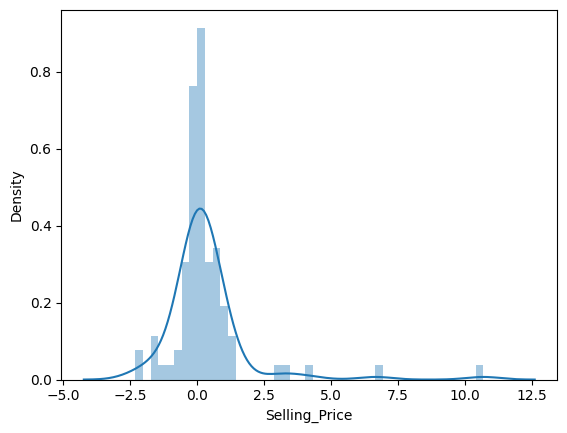

In [23]:
xgb_pred=xgb.predict(X_test)
sns.distplot(y_test-xgb_pred)

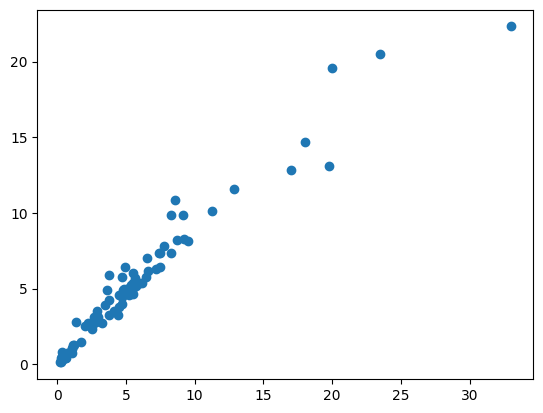

In [24]:
plt.scatter(y_test,xgb_pred)

In [25]:
xgb_MAE  = metrics.mean_absolute_error(y_test, xgb_pred)
xgb_MSE  = metrics.mean_squared_error(y_test, xgb_pred)
xgb_RMSE = np.sqrt(metrics.mean_squared_error(y_test, xgb_pred))
xgb_R2   = metrics.r2_score(y_test, xgb_pred)


print('MAE: ', xgb_MAE)
print('MSE:', xgb_MSE)
print('RMSE:', xgb_RMSE)
print('R2:', xgb_R2)

MAE:  0.7469348757378347
MSE: 2.568463396783795
RMSE: 1.6026426291546707
R2: 0.914115611367586


# CatBoostRegressor

In [26]:
cb=CatBoostRegressor()

grid = {'learning_rate': [0.03, 0.1],
        'depth': [4, 6, 10],
        'l2_leaf_reg': [1, 3, 5, 7, 9]}
cb = RandomizedSearchCV(estimator = cb, param_distributions = grid,scoring='neg_mean_squared_error', n_iter = 10, random_state=42, n_jobs = -1)

In [27]:
cb.fit(X_train,y_train)

0:	learn: 4.7513958	total: 143ms	remaining: 2m 22s
1:	learn: 4.5119164	total: 143ms	remaining: 1m 11s
2:	learn: 4.3301300	total: 144ms	remaining: 47.8s
3:	learn: 4.1363250	total: 144ms	remaining: 35.9s
4:	learn: 3.9718172	total: 145ms	remaining: 28.8s
5:	learn: 3.8095917	total: 145ms	remaining: 24.1s
6:	learn: 3.6425018	total: 146ms	remaining: 20.7s
7:	learn: 3.4983529	total: 146ms	remaining: 18.1s
8:	learn: 3.3606511	total: 147ms	remaining: 16.1s
9:	learn: 3.2383294	total: 147ms	remaining: 14.5s
10:	learn: 3.1338057	total: 147ms	remaining: 13.2s
11:	learn: 3.0202997	total: 147ms	remaining: 12.1s
12:	learn: 2.9199965	total: 148ms	remaining: 11.2s
13:	learn: 2.8628436	total: 148ms	remaining: 10.4s
14:	learn: 2.7647330	total: 149ms	remaining: 9.76s
15:	learn: 2.6790815	total: 149ms	remaining: 9.16s
16:	learn: 2.6271657	total: 149ms	remaining: 8.63s
17:	learn: 2.5505273	total: 150ms	remaining: 8.18s
18:	learn: 2.4868576	total: 150ms	remaining: 7.76s
19:	learn: 2.4771422	total: 151ms	remai

RandomizedSearchCV(estimator=<catboost.core.CatBoostRegressor object at 0x00000295FBD0EDD0>,
                   n_jobs=-1,
                   param_distributions={'depth': [4, 6, 10],
                                        'l2_leaf_reg': [1, 3, 5, 7, 9],
                                        'learning_rate': [0.03, 0.1]},
                   random_state=42, scoring='neg_mean_squared_error')

In [28]:
cb_best_param = cb.best_params_
cb_best_score = cb.best_score_

print('CATBoost Best Params: ', cb_best_param)
print('CATBoost Forest Best Score: ', cb_best_score)

CATBoost Best Params:  {'learning_rate': 0.1, 'l2_leaf_reg': 9, 'depth': 4}
CATBoost Forest Best Score:  -3.2179271237932716


<AxesSubplot: xlabel='Selling_Price', ylabel='Density'>

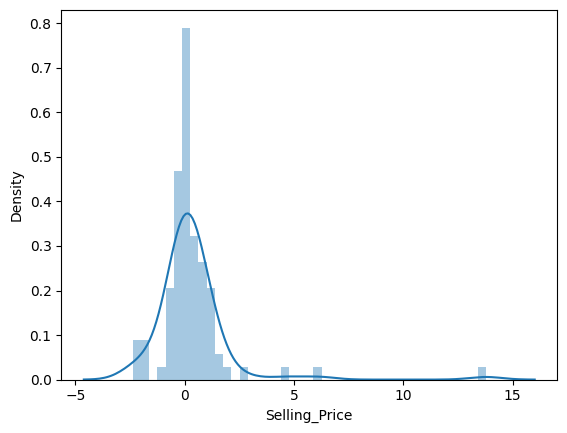

In [29]:
cb_pred = cb.predict(X_test)
sns.distplot(y_test-cb_pred)

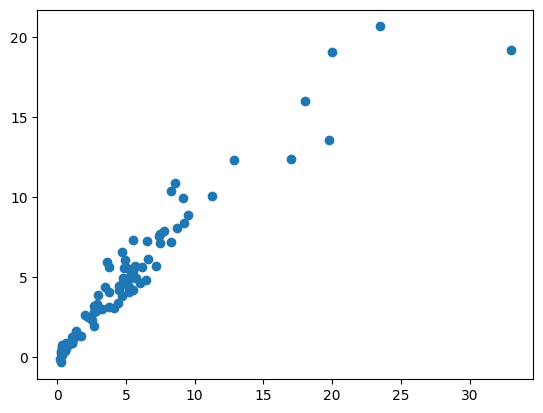

In [30]:
plt.scatter(y_test, cb_pred)
plt.show()

In [31]:
cb_MAE  = metrics.mean_absolute_error(y_test, cb_pred)
cb_MSE  = metrics.mean_squared_error(y_test, cb_pred)
cb_RMSE = np.sqrt(metrics.mean_squared_error(y_test, cb_pred))
cb_R2   = metrics.r2_score(y_test, cb_pred)

print('MAE: ', cb_MAE)
print('MSE:', cb_MSE)
print('RMSE:', cb_RMSE)
print('RMSE:', cb_R2)

MAE:  0.8568669682476366
MSE: 3.4731227057809524
RMSE: 1.8636315906801302
RMSE: 0.8838655748005345


# LGBMRegressor

In [32]:
lb=LGBMRegressor()  
lb.fit(X_train,y_train)

LGBMRegressor()

In [33]:
params = {
    "gamma": uniform(0, 0.5),
    "learning_rate": uniform(0.03, 0.3), # default 0.1 
    "max_depth": randint(2, 6), # default 3
    "n_estimators": randint(100, 150), # default 100
    "subsample": uniform(0.6, 0.4)
}

In [34]:
lb = RandomizedSearchCV(estimator = lb, param_distributions = params,scoring='neg_mean_squared_error', n_iter = 10, random_state=42, n_jobs = -1)

In [35]:
lb.fit(X_train,y_train)

RandomizedSearchCV(estimator=LGBMRegressor(), n_jobs=-1,
                   param_distributions={'gamma': <scipy.stats._distn_infrastructure.rv_continuous_frozen object at 0x00000295FC75E0B0>,
                                        'learning_rate': <scipy.stats._distn_infrastructure.rv_continuous_frozen object at 0x00000295FC392E00>,
                                        'max_depth': <scipy.stats._distn_infrastructure.rv_discrete_frozen object at 0x00000295FBBEF100>,
                                        'n_estimators': <scipy.stats._distn_infrastructure.rv_discrete_frozen object at 0x00000295FC392A10>,
                                        'subsample': <scipy.stats._distn_infrastructure.rv_continuous_frozen object at 0x00000295FC53A110>},
                   random_state=42, scoring='neg_mean_squared_error')

In [36]:
lb_best_params = lb.best_params_
lb_best_score = lb.best_score_

print('LGBMRegressor Best Params: ', lb_best_params)
print('LGBMRegressor Best Score: ', lb_best_score)

LGBMRegressor Best Params:  {'gamma': 0.34015376929388985, 'learning_rate': 0.16514977559086289, 'max_depth': 3, 'n_estimators': 103, 'subsample': 0.9768807022739411}
LGBMRegressor Best Score:  -5.776105814158411


<AxesSubplot: xlabel='Selling_Price', ylabel='Density'>

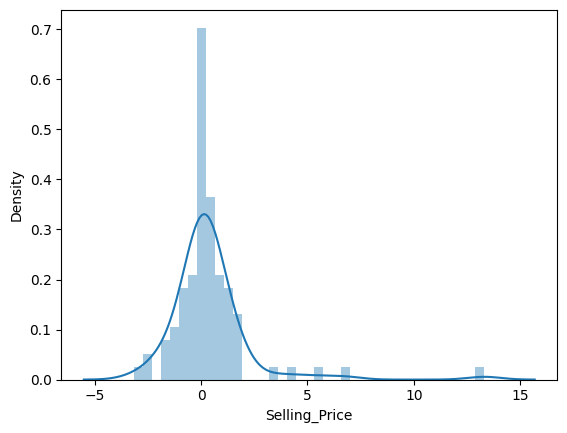

In [37]:
lb_pred = lb.predict(X_test)
sns.distplot(y_test - lb_pred)

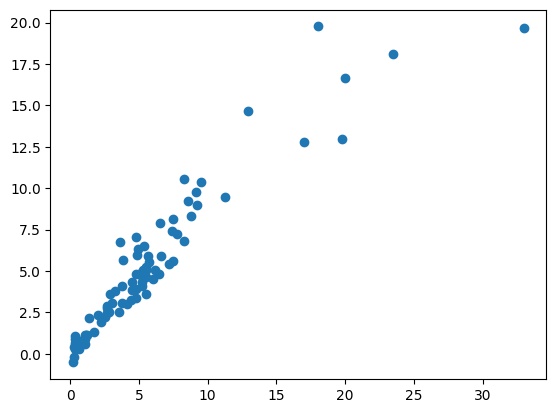

In [38]:
plt.scatter(y_test, lb_pred)
plt.show()

In [39]:
lb_MAE = metrics.mean_absolute_error(y_test, lb_pred)
lb_MSE = metrics.mean_squared_error(y_test, lb_pred)
lb_RMSE = np.sqrt(metrics.mean_squared_error(y_test, lb_pred))
lb_R2 = metrics.r2_score(y_test, lb_pred)

print('MAE: ', lb_MAE)
print('MSE:', lb_MSE)
print('RMSE:', lb_RMSE)
print('R2:', lb_R2)

MAE:  1.0132939743818592
MSE: 3.934934144002637
RMSE: 1.9836668429962319
R2: 0.8684235042283823


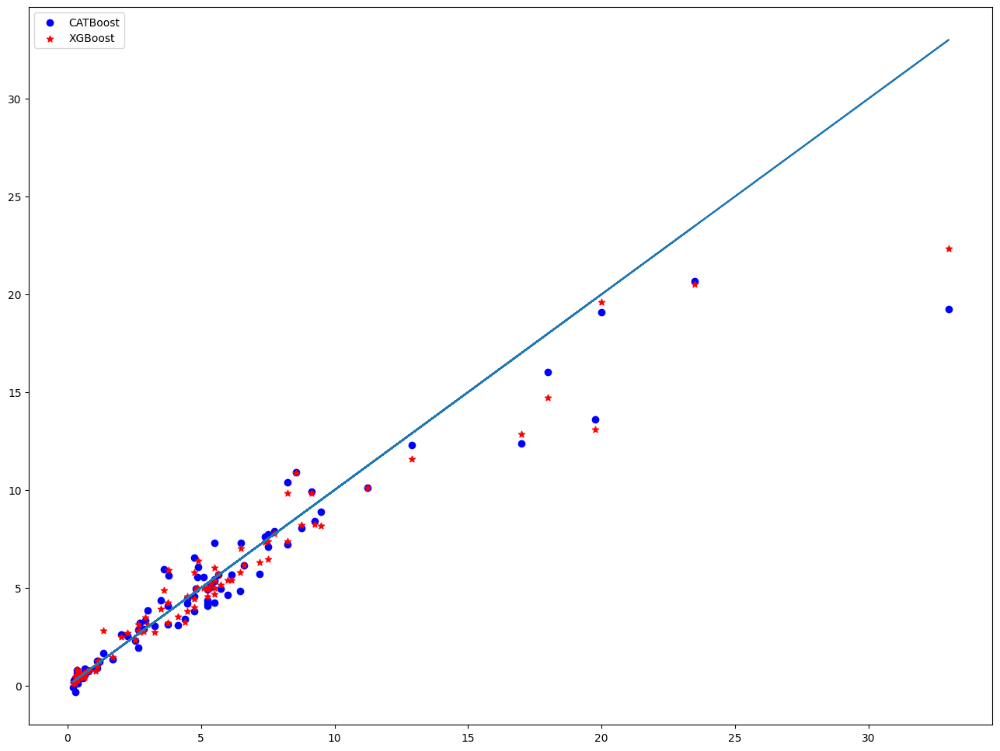

In [40]:
fig = plt.figure(figsize=(16, 12))

#plt.scatter(y_test, rf_pred,  color='b', marker = 'o', label = 'Random Forest')
#plt.scatter(y_test, lb_pred,  color='g', marker = '+', label = 'LGBM')
plt.scatter(y_test, cb_pred,  color='b', marker = 'o', label = 'CATBoost')
plt.scatter(y_test, xgb_pred, color='r', marker = '*', label = 'XGBoost')
plt.plot(y_test, y_test)
plt.legend()
plt.show()

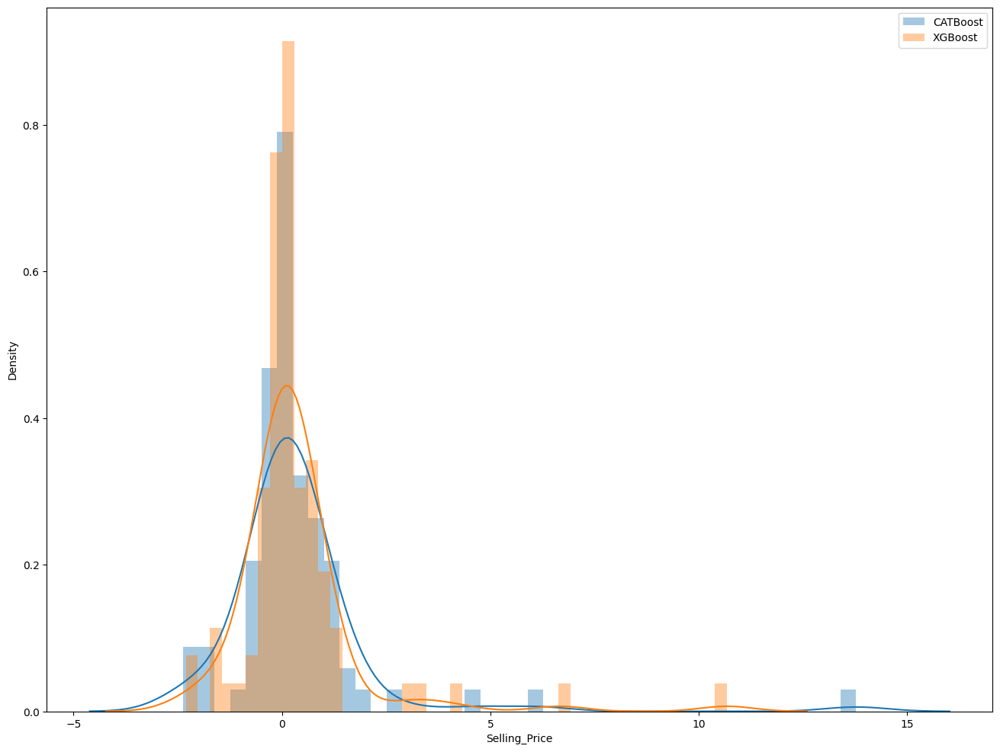

In [41]:
fig = plt.figure(figsize=(16, 12))

#sns.distplot(y_test - rf_pred, label = 'RF')
#sns.distplot(y_test - lb_pred, label = 'lb')
sns.distplot(y_test - cb_pred, label = 'CATBoost')
sns.distplot(y_test - xgb_pred, label = 'XGBoost')
#fig.legend()
#fig.legend(labels=['XGBoost','CATBoost'])
plt.legend()
plt.show()

In [42]:
compare_models = [('RandomForest',       rf_MAE,  rf_MSE,  rf_RMSE,  ''),
                  ('LGBMRegressor',      lb_MAE,  lb_MSE,  lb_RMSE,  ''),
                  ('CatBoostRegressor',  cb_MAE,  cb_MSE,  cb_RMSE,  ''),
                  ('XGBRegressor',       xgb_MAE, xgb_MSE, xgb_RMSE, 'Best Model')]

In [43]:
predict = pd.DataFrame(data = compare_models, columns=['Model', 'MAE', 'MSE', 'RMSE', 'Description'])
predict.style.background_gradient(cmap='YlOrBr')

,Model,MAE,MSE,RMSE,Description
0,RandomForest,0.885415,3.986588,1.996644,
1,LGBMRegressor,1.013294,3.934934,1.983667,
2,CatBoostRegressor,0.856867,3.473123,1.863632,
3,XGBRegressor,0.746935,2.568463,1.602643,Best Model


<Figure size 1600x1200 with 0 Axes>

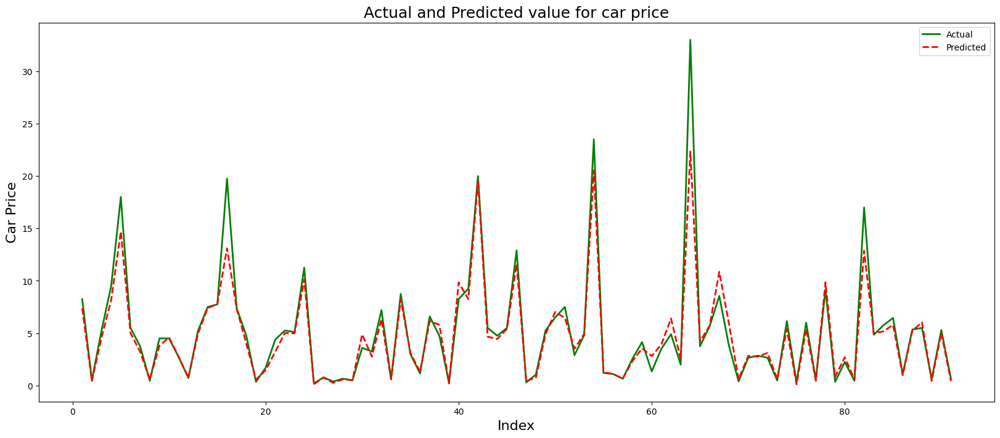

In [44]:
fig = plt.figure(figsize=(16, 12))

a = [i for i in range(1,92,1)]
p = [i for i in range(1,92,1)]

plt.figure(figsize=(20,8))
plt.plot(a, y_test, color="green", linewidth=2, linestyle="-", label = 'Actual')
plt.plot(p, xgb_pred, color="red",  linewidth=2, linestyle="--", label = 'Predicted') 
plt.title('Actual and Predicted value for car price',  fontsize=18)
plt.xlabel('Index', fontsize=16)                               
plt.ylabel('Car Price', fontsize=16)  
plt.legend()
plt.show()